In [9]:
import networkx as nx
from scipy.linalg import expm, sinm, cosm
import numpy as np
from itertools import count
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import osmnx as ox
from sklearn.metrics import mean_squared_error
import matplotlib.patches as mpatches


def cosine_distance(G, comm = None): # returns a dataframe with a matrix
    G_simple = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G_simple))
    if comm is None:
        comm = add_comm_attr(G_simple)

    comm = pd.DataFrame.from_dict(comm, orient= "columns")
    nodelist = list(G_simple)
    cd = pd.DataFrame.copy(comm)
    for i in nodelist:
        for j in nodelist:
            cd[i][j] =2 - 2*comm[i][j]/np.sqrt(comm[i][i]*comm[j][j])
    return cd

def comm_angle(G, comm = None):
    G_simple = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G_simple))
    if comm is None:
        comm = add_comm_attr(G_simple)
    comm = pd.DataFrame.from_dict(comm, orient= "columns")
    nodelist = list(G_simple)
    angle = pd.DataFrame.copy(comm)
    for i in nodelist:
        for j in nodelist:
            angle[i][j] =np.degrees(np.arccos(comm[i][j]/np.sqrt(comm[i][i]*comm[j][j])))
    return angle




def comm_distance(G, comm = None): # returns a dataframe with a matrix
    G_simple = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G_simple))
    if comm is None:
        comm = add_comm_attr(G_simple)

    comm = pd.DataFrame.from_dict(comm, orient= "columns")
    nodelist = list(G_simple)
    cd = pd.DataFrame.copy(comm)
    for i in nodelist:
        for j in nodelist:
            cd[i][j] =np.sqrt(comm[i][i] + comm[j][j] - 2*comm[i][j])
    return cd

def comm_geo(G, cd = None, comm = None): # adds mean flow as attribute and returns a matrix
  G_simple = nx.Graph(G)
  G.remove_edges_from(nx.selfloop_edges(G_simple))
  if cd is None:
    if comm is None:
      comm = add_comm_attr(G_simple)
    cd = comm_distance(G, comm)
  dfA = nx.to_pandas_adjacency(G)
  X = (dfA*cd)
  GX = nx.from_pandas_adjacency(X, nx.DiGraph)
  dfSP = nx.to_pandas_adjacency(G)
  # j = dict()
  bet = nx.edge_betweenness_centrality(GX,normalized = False, weight = "weight")
  j = dict(nx.all_pairs_dijkstra_path_length(GX, weight = "weight"))
  # for i in invest:
  #     j[i[0]] = i[1]

  teste = pd.DataFrame.from_dict(j, orient = "index")
  for i in teste.columns:
    for j in teste.columns:
      if np.isnan(teste[i][j]):
        dfSP[i][j] = 0
      else:
        dfSP[i][j] = teste[i][j]
  nx.set_node_attributes(G, values=(dfSP.mean()).to_dict(), name="mean_flow")
  return dfSP, bet


def add_CCC(G, comm = None, cd = None): # returns a dict with a centrality
    if cd is None:
        cd = cosine_distance(G,comm)
    d = (1/cd.sum())
    nx.set_node_attributes(G, values=d.to_dict(), name="CCC")
    return d




def add_comm_attr(G): # matrix and mean comm as attr
    G_simple = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G_simple))
    nodelist = list(G_simple)
    A = nx.to_numpy_array(G_simple, nodelist)

    Aexp2 = expm(A)
    mapping = dict(zip(nodelist, range(len(nodelist))))

    c = {}
    d = {}
    for u in G_simple:
        c[u] = {}
        for v in G_simple:
            c[u][v] = float(Aexp2[mapping[u], mapping[v]])
        d[u] = np.mean(list(c[u].values()))

    nx.set_node_attributes(G, values=d, name="comm")
    return c

def plotting(G, value, pos = None):
    groups = nx.get_node_attributes(G,value).values()
    mapping = dict(zip(count(),sorted(groups)))

    nodes = G.nodes()
    colors = [mapping[n] for n in nodes]

    # drawing nodes and edges separately so we can capture collection for colobar
    if not pos:
        pos = nx.spring_layout(G)
    plt.figure(figsize=(10,10))
    ec = nx.draw_networkx_edges(G, pos, alpha=0.2)
    nc = nx.draw_networkx_nodes(G, pos, nodelist=nodes, node_color=colors, node_size=100, cmap=plt.cm.jet)
    plt.colorbar(nc)
    plt.axis('off')
    plt.show()


def graph_folium_bg(G, n_attribute = None, e_attribute = None, cmap = "hot", poly = None):
    nodes, edges = ox.graph_to_gdfs(G)
    if poly is not None:
        m = poly.explore()
        m = edges.explore(m=m, column = e_attribute, cmap = cmap, color = "black")
    else:
        m = edges.explore(column = e_attribute, cmap = cmap, color = "black")
    m = nodes.explore(m=m, column = n_attribute, cmap = cmap, color = "black")
    return m



seed = 555
nodes = 1000

In [3]:
# G = nx.connected_watts_strogatz_graph(600, 4, 0.5)

def vulnerabilities(H):
    # G = H.copy()
    G = nx.Graph(H)
    N_tot = len(G)*(len(G)-1)


    comm = add_comm_attr(G) # matrix
    comm_uv = pd.DataFrame.from_dict(comm, orient= "columns") # matrix
    np.fill_diagonal(comm_uv.values, 0)
    nx.set_node_attributes(G, values=comm_uv.mean(), name="comm_uv")
    cd = cosine_distance(G, comm) # matrix
    CCC = add_CCC(G, comm, cd) # vector
    comm_dist = comm_distance(G, comm) # matrix
    comm_ang = comm_angle(G, comm) # matrix
    sp = pd.DataFrame.from_dict(dict(nx.shortest_path_length(G)))
    efi = (1/sp).reset_index()
    efi[efi == np.inf] = 0

    G_efi =  efi.sum()[1:].sum()/N_tot
    G_comm = pd.DataFrame.from_dict(comm, orient= "columns").sum().sum()/N_tot
    G_comm_uv = comm_uv.sum().sum()/N_tot
    G_cd = cd.sum()[1:].sum()/N_tot
    G_CCC = CCC.sum()/len(G)
    G_comm_dist = comm_dist.sum()[1:].sum()/N_tot
    G_comm_angle = comm_ang.sum()[1:].sum()/N_tot
    V_comm = []
    V_comm_uv = []
    V_cd = []
    V_CCC = []
    V_comm_dist = []
    V_comm_ang = []
    V_efi = []

    for i in H.nodes:
        G = H.copy()
        G.remove_edges_from(H.edges(i)) # disconnecting the node

        # comm and efi

        comm = add_comm_attr(G) # matrix
        comm_uv = pd.DataFrame.from_dict(comm, orient= "columns") # matrix
        np.fill_diagonal(comm_uv.values, 0)
        nx.set_node_attributes(G, values=comm_uv.mean(), name="comm_uv")
        cd = cosine_distance(G, comm) # matrix
        CCC = add_CCC(G, comm, cd) # vector
        comm_dist = comm_distance(G, comm) # matrix
        comm_ang = comm_angle(G, comm) # matrix
        sp = pd.DataFrame.from_dict(dict(nx.shortest_path_length(G)))
        _efi = (1/sp).reset_index()
        _efi[_efi == np.inf] = 0 # removing infs, since if there is no connection the efficiency = 0

        V_efi.append((G_efi - _efi.sum()[1:].sum()/N_tot)/G_efi)
        V_comm.append((G_comm - pd.DataFrame.from_dict(comm, orient= "columns").sum().sum()/N_tot)/G_comm)
        V_comm_uv.append((G_comm_uv - comm_uv.sum().sum()/N_tot)/G_comm_uv)
        V_cd.append((G_cd - cd.sum().sum()/N_tot)/G_cd)
        V_CCC.append((G_CCC - CCC.sum()/len(G))/G_CCC)
        V_comm_dist.append((G_comm_dist - comm_dist.sum().sum()/N_tot)/G_comm_dist)
        V_comm_ang.append((G_comm_angle - comm_ang.sum().sum()/N_tot)/G_comm_angle)

    df_vuls = pd.DataFrame(index = H.nodes)
    df_vuls["Communicability"] = pd.DataFrame.from_dict(comm, orient= "columns").sum()/len(H)
    df_vuls["Comm-"] = comm_uv.sum()/len(G)
    df_vuls["Efficiency"] = efi.sum()[1:]/len(G)
    df_vuls["Vulnerability Communicability"] = V_comm
    df_vuls["Vulnerability Communicability 2"] = V_comm_uv
    df_vuls["Vulnerability"] = V_efi
    df_vuls["Vulnerability CD"] = V_cd
    df_vuls["Vulnerability CCC"] = V_CCC
    df_vuls["Vulnerability Comm Dist"] = V_comm_dist
    df_vuls["Vulnerability Comm Ang"] = V_comm_ang
    for i in df_vuls.columns:
        nx.set_node_attributes(H, df_vuls[i], i)
    return df_vuls, H

In [4]:
def graph_folium_bg(G, n_attribute = None, e_attribute = None, cmap = "hot", poly = None):
    nodes, edges = ox.graph_to_gdfs(G)
    if poly is not None:
        m = poly.explore()
        m = edges.explore(m=m, column = e_attribute, cmap = cmap, color = "black")
    else:
        m = edges.explore(column = e_attribute, cmap = cmap, color = "black")
    m = nodes.explore(m=m, column = n_attribute, cmap = cmap, color = "black")
    return m

# Main

In [5]:
# G = nx.karate_club_graph()
# G = nx.connected_watts_strogatz_graph(100, 4, 0.5)
# G = nx.erdos_renyi_graph(150, 0.1, seed=55, directed=False)
#
# pos = nx.spring_layout(G)
# latlong, city = (40.74818745365401, -73.98525697263685), "Manhattan"
# latlong = (-15.800092832268064, -47.86717316435825) # Brasilia
latlong, city = (41.390, 2.166), 'Barcelona'
# latlong, city = (-23.546, -46.634), "São Paulo"
dist = 4000
G = ox.graph_from_point(latlong, dist = dist, truncate_by_edge = True, network_type="drive")
#
print(G)

# plt.figure(figsize=(10,10))
# ec = nx.draw_networkx_edges(G, pos, alpha=0.2)
# nc = nx.draw_networkx_nodes(G, pos, node_size=100, cmap=plt.cm.jet)
# plt.axis('off')
# plt.show()

MultiDiGraph with 6474 nodes and 11950 edges


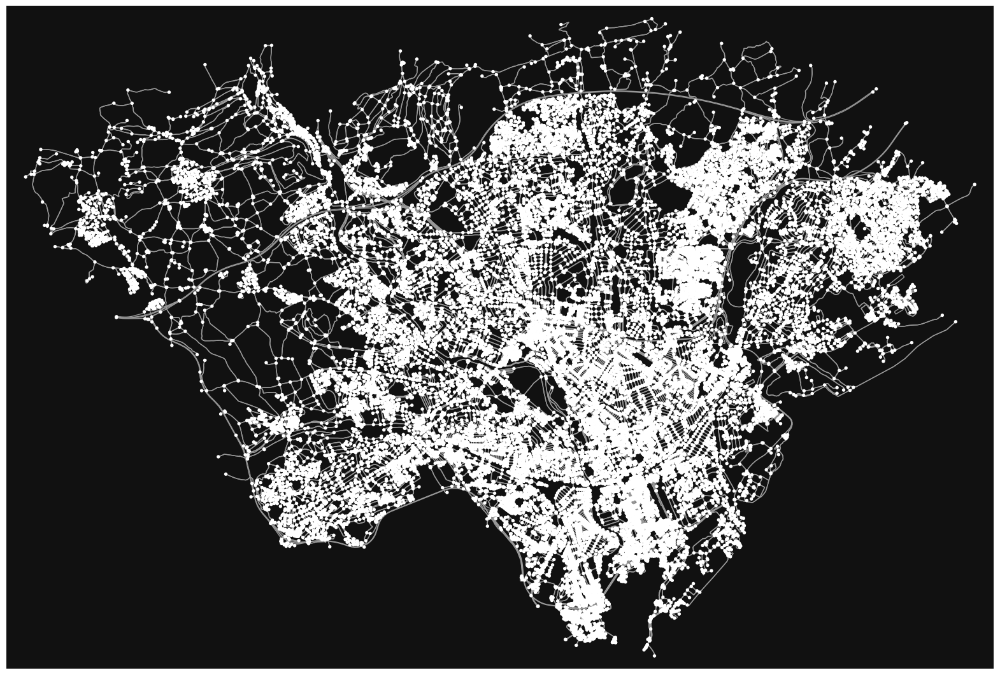

(<Figure size 2000x2000 with 1 Axes>, <Axes: >)

In [28]:
ox.plot_graph(ox.graph_from_place("Cardiff, UK", truncate_by_edge = True), figsize = (20,20))


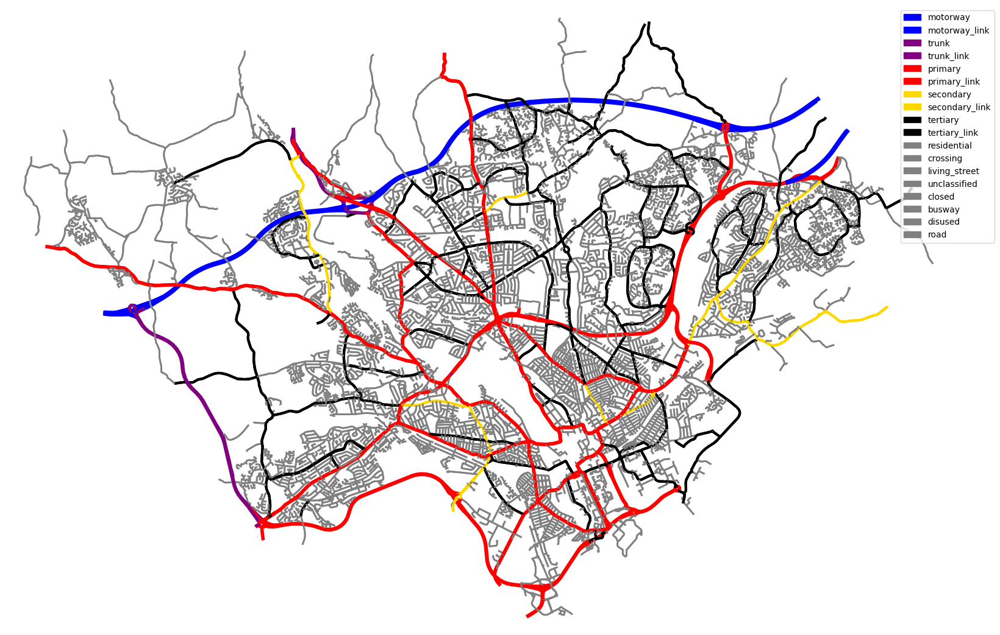

In [26]:
G = ox.graph_from_place("Cardiff, UK", truncate_by_edge = True, network_type="drive")


hwy_color = {'motorway': 'blue',
             'motorway_link': 'blue',
             'trunk': 'purple',
             'trunk_link': 'purple',
             'primary': 'red',
             'primary_link': 'red',
             'secondary': 'gold',
             'secondary_link' : 'gold',
             'tertiary': 'black',
             'tertiary_link': 'black',
             'residential': 'gray',
             'crossing': 'gray',
             'living_street': 'gray',
             'unclassified': 'gray',
             'closed': 'gray',
             'busway': 'gray',
             'disused':'gray',
             'road': 'gray'}

hwy_width = {'motorway': 5,
             'motorway_link': 5,
             'trunk': 4,
             'trunk_link': 4,
             'primary': 4,
             'primary_link': 4,
             'secondary': 3,
             'secondary_link' : 3,
             'tertiary': 3,
             'tertiary_link': 3,
             'residential': 2,
             'crossing': 2,
             'living_street': 2,
             'unclassified': 2,
             'closed': 2,
             'busway': 2,
             'disused': 2,
             'road': 2}


nodes, edges = ox.graph_to_gdfs(G)

teste = edges.map(lambda x: x[0] if isinstance(x, list) else x)
ec = teste.replace(hwy_color).highway
el = teste.replace(hwy_width).highway
patches = []
for i in hwy_color:
    patches.append(mpatches.Patch(color= hwy_color[i], label=i))

fig, ax = ox.plot_graph(
    G, bgcolor="w", node_color='k', edge_linewidth = el, node_size=0, edge_color=ec, figsize = (20,20), show = False, close = False
)
ax.legend(handles = patches, bbox_to_anchor=(1.05, 1))

In [23]:
edges.explore()

In [8]:
print(G)

MultiDiGraph with 11823 nodes and 25767 edges


In [6]:
df, bet = comm_geo(G)

KeyboardInterrupt: 

In [ ]:
# df, G = vulnerabilities(G)
ew_flow = dict()
ew_bet = dict()
for i in G.edges:
  ew_flow[(i[0], i[1], 0)] = df[i[0]][i[1]]
  # ew_bet[(i[0], i[1], 0)] = bet[(i[0], i[1])]

eb = nx.edge_betweenness_centrality(G, normalized = False, weight = "length")
# nx.set_edge_attributes(G, eb, "Edge betweenness")
nx.set_edge_attributes(G, ew_flow, "Cost of returnal")
# nx.set_edge_attributes(G, ew_bet, "Flow betweenness")

In [ ]:
categories = ['motorway', 'motorway_link', 'trunk', 'trunk_link', 'primary', 'primary_link', 'secondary', 'secondary_link', 'tertiary', 'tertiary_link', 'residential', 'living_street', 'unclassified']

In [ ]:
nodes, edges = ox.graph_to_gdfs(G)
edges["highway"] = edges.highway.map(lambda x: x[0] if isinstance(x, list) else x)
nodes.to_csv(f"{city}_nodes.csv")
edges.to_csv(f"{city}_edges.csv")

In [ ]:
fig = px.box(edges, x = "highway", y = "Cost of returnal", title = city)
fig.update_xaxes(categoryorder='array', categoryarray=categories)
fig.write_image(f"{city}_box_classes.pdf")
fig

In [ ]:
hwy_color = {'motorway': 'red',
             'motorway_link': 'firebrick',
             'trunk': 'orange',
             'trunk_link': 'orange',
             'primary': 'gold',
             'primary_link': 'olive',
             'secondary': 'green',
             'secondary_link' : 'green',
             'tertiary': 'green',
             'tertiary_link': 'green',
             'residential': 'blue',
             'crossing': 'k',
             'living_street': 'k',
             'unclassified': 'k'}
teste = edges.map(lambda x: x[0] if isinstance(x, list) else x)
ec = teste.replace(hwy_color).highway

In [ ]:
import matplotlib.patches as mpatches
patches = []
for i in hwy_color:
    patches.append(mpatches.Patch(color= hwy_color[i], label=i))

In [ ]:
ec

u            v           key
582438       260686562   0       green
             260685848   0       green
582442       2348890859  0      orange
             1964865727  0      orange
587972       6076848285  0        gold
                                 ...  
11772486139  453648993   0      orange
11772486772  1964865771  0      orange
             8480345242  0      orange
11812733018  2832098720  0        blue
             60685367    0        blue
Name: highway, Length: 13055, dtype: object

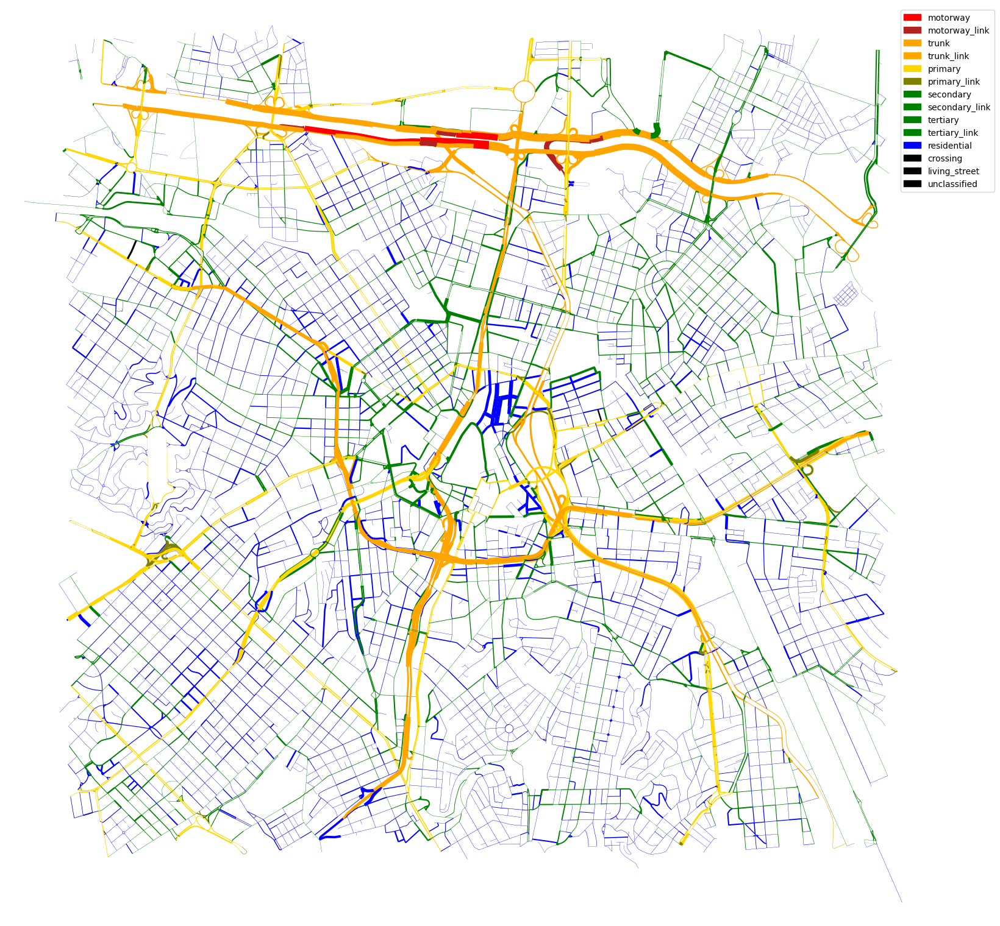

In [ ]:
fig, ax = ox.plot_graph(
    G, bgcolor="w", node_color='k', node_size=0, edge_linewidth=edges["Cost of returnal"]/max(edges["Cost of returnal"])*10, edge_color=ec, figsize = (20,20), show = False, close = False
)
ax.legend(handles = patches, bbox_to_anchor=(1.05, 1))
fig.savefig(f"{city}_COR_class.png", bbox_inches='tight')

In [ ]:
fig = px.bar(edges.highway.value_counts(normalize=True), title = city)
fig.update_xaxes(categoryorder='array', categoryarray=categories)
fig

In [ ]:
edges.sort_values(by="Cost of returnal")["highway"].head(100).value_counts(normalize=True)

highway
residential       0.25
secondary         0.20
primary           0.16
trunk             0.12
tertiary          0.10
secondary_link    0.05
motorway_link     0.04
trunk_link        0.03
primary_link      0.03
motorway          0.02
Name: proportion, dtype: float64

In [ ]:
fig = px.bar(edges.sort_values(by="Cost of returnal")["highway"].head(len(edges)//100).value_counts(normalize=True), title = "Entire data set")
fig.update_xaxes(categoryorder='array', categoryarray=categories)
fig.update_layout(    font=dict(
        size=25,
        color="black"
    ))
fig.write_image(f"{city}_1percent_classes.pdf", width=1000, height=1000)
fig

In [ ]:
fig = px.bar(edges.highway.value_counts(normalize=True), title = "Top 1% COR distribution")
fig.update_xaxes(categoryorder='array', categoryarray=categories)
fig.update_layout(    font=dict(
        size=25,
        color="black"
    ))
fig.write_image(f"{city}_all_classes.pdf", width=1000, height=1000)
fig

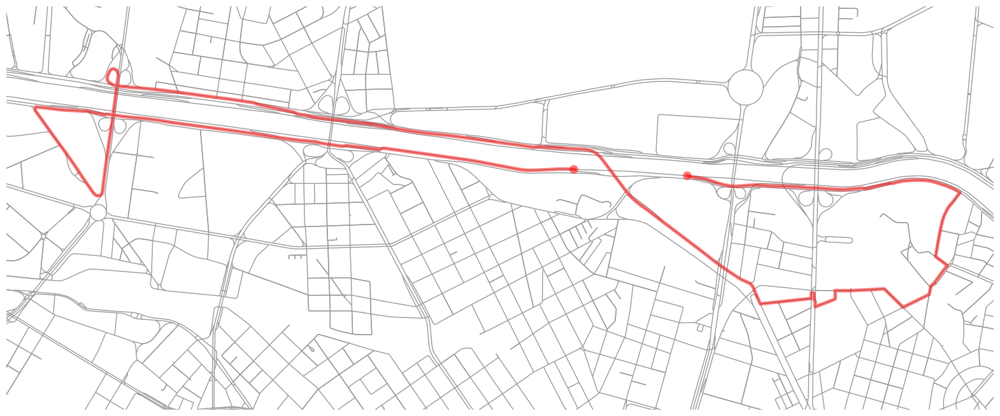

In [ ]:
fig, ax = ox.plot_graph_route(G, nx.shortest_path(G, 25777974, 1815130245, weight = "length"), bgcolor="w", node_color='k', node_size=0, figsize = (20,20), bbox = (-23.510027186580285, -23.531972813419714,  -46.614760054710925,  -46.673239945289076))

fig.savefig(f"{city}_route.png", bbox_inches='tight')

In [ ]:
(-23.510027186580285,
 -23.531972813419714,
 -46.594760054710925,
 -46.673239945289076)

In [ ]:
ox.utils_geo.bbox_from_point((-23.546, -46.634), dist)

(-23.510027186580285,
 -23.581972813419714,
 -46.594760054710925,
 -46.673239945289076)

In [ ]:
edges.explore(column = "Cost of returnal")

In [ ]:
px.histogram(edges, x = "Cost of returnal")

In [ ]:
edges[edges.flow > edges.flow.quantile(0.95)].highway.value_counts()

In [ ]:
px.bar(edges[edges["flow"] > edges["flow"].quantile(0.9)].highway.value_counts(normalize=True), title = city)

In [ ]:
edges.columns

Index(['osmid', 'oneway', 'lanes', 'name', 'highway', 'maxspeed', 'reversed',
       'length', 'geometry', 'flow', 'Flow betweenness', 'width', 'access',
       'bridge', 'tunnel', 'ref'],
      dtype='object')

# cut

In [ ]:
edges.highway.value_counts(normalize=True)

residential                     0.325023
tertiary                        0.195753
primary                         0.168975
secondary                       0.157895
trunk                           0.045245
trunk_link                      0.036011
living_street                   0.025854
primary_link                    0.023084
tertiary_link                   0.013850
secondary_link                  0.005540
[primary, primary_link]         0.001847
[living_street, residential]    0.000923
Name: highway, dtype: float64

In [ ]:
edges[edges.flow > edges.flow.quantile(0.9)].explore(column = "flow")

In [ ]:
edges[edges.flow > edges.flow.quantile(0.9)]

osmid  oneway lanes  \
u          v          key                                                    
25872232   25872212   0                            909387495    True     3   
25872254   2389060601 0                            909387495    True     3   
25872264   1420146734 0                              8375726    True     2   
           2389060616 0                             72470714    True     1   
25928842   60685898   0       [779584032, 4331470, 48651838]    True     4   
...                                                      ...     ...   ...   
8073587469 1938339522 0               [183462554, 866174714]    True     1   
           304023022  0    [866174710, 442626692, 936461534]    True     4   
8659531007 6595269581 0                             51835035    True   NaN   
8659531010 8659531007 0                            934342387    True     1   
8681062441 60686036   0     [470252928, 48661202, 425850168]    True     3   

                                                                       name  \
u          v          key                                                     
25872232   25872212   0                                   Avenida do Estado   
25872254   2389060601 0                                   Avenida do Estado   
25872264   1420146734 0                                 Parque Dom Pedro II   
           2389060616 0                                                 NaN   
25928842   60685898   0    [Túnel Papa João Paulo II, Avenida Prestes Maia]   
...                                                                     ...   
8073587469 1938339522 0                                                 NaN   
           304023022  0                                    Avenida Mercúrio   
8659531007 6595269581 0                                      Praça São Vito   
8659531010 8659531007 0                                                 NaN   
8681062441 60686036   0                               Viaduto Nove de Julho   

                                highway maxspeed reversed   length bridge  \
u          v          key                                                   
25872232   25872212   0           trunk       50    False  196.380    NaN   
25872254   2389060601 0           trunk       50    False   35.270    NaN   
25872264   1420146734 0        tertiary       50    False  129.049    NaN   
           2389060616 0      trunk_link      NaN    False   31.261    NaN   
25928842   60685898   0           trunk       50    False  636.083    NaN   
...                                 ...      ...      ...      ...    ...   
8073587469 1938339522 0      trunk_link      NaN    False   33.589    yes   
           304023022  0         primary       50    False   34.791    yes   
8659531007 6595269581 0     residential      NaN    False  144.617    NaN   
8659531010 8659531007 0    primary_link      NaN    False   30.660    NaN   
8681062441 60686036   0       secondary       50    False  242.999    yes   

                                                                    geometry  \
u          v          key                                                      
25872232   25872212   0    LINESTRING (-46.62977 -23.54450, -46.63011 -23...   
25872254   2389060601 0    LINESTRING (-46.62912 -23.54282, -46.62925 -23...   
25872264   1420146734 0    LINESTRING (-46.62976 -23.54363, -46.63001 -23...   
           2389060616 0    LINESTRING (-46.62976 -23.54363, -46.62973 -23...   
25928842   60685898   0    LINESTRING (-46.63771 -23.54689, -46.63769 -23...   
...                                                                      ...   
8073587469 1938339522 0    LINESTRING (-46.62821 -23.54151, -46.62844 -23...   
           304023022  0    LINESTRING (-46.62821 -23.54151, -46.62838 -23...   
8659531007 6595269581 0    LINESTRING (-46.62729 -23.54284, -46.62831 -23...   
8659531010 8659531007 0    LINESTRING (-46.62705 -23.54299, -46.62708 -23...   
8681062441 60686036   0    LINESTRING (-46.64249 -

In [ ]:
H = ox.graph_from_point(latlong, dist = dist, truncate_by_edge = True, network_type="drive")
flow_edges = edges["flow"].dropna()
rms_list = []
for i in list(edges.sort_values("flow", ascending = False).head(5).index):
  K = ox.graph_from_point(latlong, dist = dist, truncate_by_edge = True, network_type="drive")
  K.remove_edge(i[0], i[1], i[2])
  df = comm_geo(K)
  ew_flow = dict()
  for k in G.edges:
    ew_flow[(k[0], k[1], 0)] = df[k[0]][k[1]]

  nx.set_edge_attributes(K, ew_flow, "flow")
  nodes_K, edges_K = ox.graph_to_gdfs(K)
  rms_list.append(mean_squared_error(flow_edges[edges_K["flow"].dropna().index], edges_K["flow"].dropna(), squared = True))

In [ ]:
rms_list

[0.0016245680944423403,
 7.005619759929184e-05,
 0.00026626119393808245,
 0.00023062620057613683,
 6.252454226161531]

In [ ]:
edges.loc[i[0], i[1]]

<ipython-input-147-02861563c6fb>:1: PerformanceWarning:

indexing past lexsort depth may impact performance.



,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,bridge,geometry,flow,ref,tunnel,width,access
key,,,,,,,,,,,,,,,
0,128521820,True,NaN,Rua Comendador Abdo Schahin,residential,NaN,False,98.957,NaN,"LINESTRING (-46.63177 -23.54191, -46.63193 -23...",57.857584,NaN,NaN,NaN,NaN


In [ ]:
edges_K.loc[248111159,  248111144]

<ipython-input-149-461f69d1ec5f>:1: PerformanceWarning:

indexing past lexsort depth may impact performance.



,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,bridge,geometry,flow,ref,tunnel,width,access
key,,,,,,,,,,,,,,,
0,23013197,True,NaN,Rua Lucrécia Leme,residential,NaN,False,43.021,NaN,"LINESTRING (-46.63193 -23.54279, -46.63235 -23...",0.0,NaN,NaN,NaN,NaN


In [ ]:
edges.sort_values("flow", ascending = False).head(5)

,,,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,bridge,geometry,flow,ref,tunnel,width,access
u,v,key,,,,,,,,,,,,,,,
4511170990,60685476,0,"[643958483, 454570244, 936107421, 48661214]",True,2,"[Rua da Consolação, Rua Quirino de Andrade, Ru...",tertiary,NaN,False,348.547,NaN,"LINESTRING (-46.64256 -23.54803, -46.64245 -23...",61.495386,NaN,NaN,NaN,NaN
248111159,248111063,0,128521820,True,NaN,Rua Comendador Abdo Schahin,residential,NaN,False,81.729,NaN,"LINESTRING (-46.63193 -23.54279, -46.63196 -23...",58.202211,NaN,NaN,NaN,NaN
248110880,248110883,0,"[23013208, 424586833]",True,NaN,Rua Comendador Afonso Kherlakian,residential,40,False,46.039,NaN,"LINESTRING (-46.63177 -23.54191, -46.63209 -23...",58.010165,NaN,NaN,NaN,NaN
248111159,248111144,0,23013197,True,NaN,Rua Lucrécia Leme,residential,NaN,False,43.021,NaN,"LINESTRING (-46.63193 -23.54279, -46.63235 -23...",58.009661,NaN,NaN,NaN,NaN
248110880,248111159,0,128521820,True,NaN,Rua Comendador Abdo Schahin,residential,NaN,False,98.957,NaN,"LINESTRING (-46.63177 -23.54191, -46.63193 -23...",57.857584,NaN,NaN,NaN,NaN


In [ ]:
(flow_edges[edges_K["flow"].dropna().index] - edges_K["flow"]).sort_values(ascending = True).head(10)

u          v           key
248110870  248110880   0     -1.046280e-01
248110882  248110883   0     -4.366958e-02
248111144  248110885   0     -4.125799e-02
248110885  248111143   0     -1.403778e-02
248111063  248110873   0     -8.721354e-03
25872212   25872075    0     -1.104894e-12
175993568  25872236    0     -1.026734e-12
445043035  133484408   0     -9.379164e-13
445043024  661211993   0     -9.379164e-13
661211993  2389060528  0     -9.379164e-13
Name: flow, dtype: float64

In [ ]:
i = list(edges.sort_values("flow", ascending = False).head(10).index)[4]
K = ox.graph_from_point(latlong, dist = dist, truncate_by_edge = True, network_type="drive")
K.remove_edge(i[0], i[1], i[2])
df = comm_geo(K)
ew_flow = dict()
for i in K.edges:
  ew_flow[(i[0], i[1], 0)] = df[i[0]][i[1]]

nx.set_edge_attributes(K, ew_flow, "flow")
nodes_K, edges_K = ox.graph_to_gdfs(K)
rms_list.append(mean_squared_error(edges["flow"].loc[edges_K.index], edges_K["flow"], squared = True))

ValueError: Input contains NaN.

In [ ]:
edges_K.explore(column= "flow")

In [ ]:
H.remove_edge(597282, 130009702)
t1,t2 = ox.graph_to_gdfs(H)

t2

osmid  oneway lanes  \
u           v          key                                                    
597282      25872025   0               [944404757, 974489742]    True     2   
597283      445043546  0                             37916481    True   NaN   
            25871833   0                           1080789231    True     3   
25871670    25871831   0                             15260247    True     2   
            25872025   0               [923545472, 945278713]    True     2   
...                                                       ...     ...   ...   
10573115224 151243285  0    [246490209, 1232828550, 25619383]    True     4   
10724416487 2389062254 0                            237745078    True     3   
11073528287 3609406630 0                            252790570    True     2   
            4307635045 0                            355326292    True   NaN   
11117108151 247949665  0                            447117762    True     3   

                                                      name      highway  \
u           v          key                                                
597282      25872025   0                 Avenida do Estado        trunk   
597283      445043546  0                   Rua da Figueira  residential   
            25871833   0                 Avenida do Estado      primary   
25871670    25871831   0                   Rua da Figueira        trunk   
            25872025   0                 Avenida do Estado        trunk   
...                                                    ...          ...   
10573115224 151243285  0    Viaduto Vinte e Cinco de Março      primary   
10724416487 2389062254 0                 Avenida do Estado        trunk   
11073528287 3609406630 0            Avenida Rangel Pestana      primary   
            4307635045 0                   Rua Pires Ramos  residential   
11117108151 247949665  0                  Rua Tabatinguera    secondary   

                           maxspeed reversed   length  \
u           v          key                              
597282      25872025   0         50    False  121.232   
597283      445043546  0         20    False   78.114   
            25871833   0         50    False  123.645   
25871670    25871831   0        NaN    False   52.219   
            25872025   0         50    False  268.772   
...                             ...      ...      ...   
10573115224 151243285  0         50    False  134.268   
10724416487 2389062254 0         50    False   81.977   
11073528287 3609406630 0         40    False   37.295   
            4307635045 0        NaN    False   79.770   
11117108151 247949665  0         40    False  164.944   

                                                                     geometry  \
u           v          key                                                      
597282      25872025   0    LINESTRING (-46.62613 -23.55109, -46.62633 -23...   
597283      445043546  0    LINESTRING (-46.62526 -23.55333, -46.62520 -23...   
            25871833   0    LINESTRING (-46.62526 -23.55333, -46.62535 -23...   
25871670    25871831   0    LINESTRING (-46.62575 -23.55238, -46.62575 -23...   
            25872025   0    LINESTRING (-46.62575 -23.55238, -46.62579 -23...   
...                                                                       ...   
10573115224 151243285  0    LINESTRING (-46.62890 -23.54940, -46.62883 -23...   
10724416487 2389062254 0    LINESTRING (-46.62759 -23.54036, -46.62747 -23...   
11073528287 3609406630 0    LINESTRING (-46.62513 -23.54735, -46.62519 -23...   
            4307635045 0    LINESTRING (-46.62513 -23.54735, -46.62516 -23...   
11117108151 247949665  0    LINESTRING (-46.62915 -23.55236, -46.62914 -23...   

                               ref tunnel width bridge access  
u           v          key                                     
597282      25872025   0       NaN    NaN   NaN    NaN    NaN  
597283      445043546  0       NaN    NaN   NaN    NaN    NaN  


In [ ]:
nc = ox.plot.get_node_colors_by_attr(G, "mean_flow", cmap="viridis", num_bins  = 4, equal_size = True)
ec = ox.plot.get_edge_colors_by_attr(G, "flow", cmap="viridis", num_bins  = 4, equal_size = False)

fig, ax = ox.plot_graph(
    G, bgcolor="w", node_color=nc, edge_color = ec,node_size=50, edge_linewidth=2, figsize = (30,30)
)

In [ ]:
ec

587993       459347433    0    (0.993248, 0.906157, 0.143936, 1.0)
             176011687    0    (0.993248, 0.906157, 0.143936, 1.0)
597282       130009702    0    (0.993248, 0.906157, 0.143936, 1.0)
             25872025     0    (0.993248, 0.906157, 0.143936, 1.0)
597283       445043546    0    (0.993248, 0.906157, 0.143936, 1.0)
                                              ...                 
11384462346  11384462347  0    (0.267004, 0.004874, 0.329415, 1.0)
             11384462348  0    (0.267004, 0.004874, 0.329415, 1.0)
             11384462345  0    (0.267004, 0.004874, 0.329415, 1.0)
11384462347  11384462346  0    (0.267004, 0.004874, 0.329415, 1.0)
11384462348  11384462346  0    (0.267004, 0.004874, 0.329415, 1.0)
Length: 3653, dtype: object

In [ ]:
fig = px.scatter(df, "Communicability", "Vulnerability Communicability", trendline="ols")
fig.show()

results = px.get_trendline_results(fig)

print(results.px_fit_results.iloc[0].summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.225
Model:                            OLS   Adj. R-squared:                  0.220
Method:                 Least Squares   F-statistic:                     42.17
Date:                Fri, 15 Dec 2023   Prob (F-statistic):           1.25e-09
Time:                        14:50:52   Log-Likelihood:                 505.49
No. Observations:                 147   AIC:                            -1007.
Df Residuals:                     145   BIC:                            -1001.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0033      0.002     -1.896      0.0

In [ ]:
df

,Communicability,Comm-,Efficiency,Vulnerability Communicability,Vulnerability Communicability 2,Vulnerability,Vulnerability CD,Vulnerability CCC,Vulnerability Comm Dist,Vulnerability Comm Ang
60641069,0.088651,0.072179,0.152987,0.000000,0.000000,0.225341,-0.006907,0.000000,-0.006399,-0.006888
60641076,0.166025,0.143110,0.186320,0.012144,0.013643,0.229908,-0.007213,0.000308,-0.004275,-0.007084
60641080,0.095796,0.079405,0.157718,0.000000,0.000000,0.227178,-0.006907,0.000000,-0.006399,-0.006888
60641083,0.144828,0.118894,0.165155,0.000000,0.000000,0.227640,-0.006907,0.000000,-0.006399,-0.006888
60641089,0.228250,0.198042,0.222338,0.031154,0.035258,0.261248,-0.007812,0.000902,-0.001864,-0.007461
...,...,...,...,...,...,...,...,...,...,...
9965301287,0.031380,0.020548,0.116978,0.000000,0.000000,0.224375,-0.006907,0.000000,-0.006399,-0.006888
9965301288,0.141962,0.118831,0.164123,0.000000,0.000000,0.243584,-0.006907,0.000000,-0.006399,-0.006888
9967142732,0.118502,0.101211,0.163556,0.000000,0.000000,0.230604,-0.006907,0.000000,-0.006399,-0.006888
9976328651,0.065253,0.049679,0.140094,0.000000,0.000000,0.225368,-0.006907,0.000000,-0.006399,-0.006888


In [ ]:
G.out_degree

OutMultiDegreeView({60641069: 2, 60641076: 2, 60641080: 2, 60641083: 3, 60641089: 3, 60641090: 3, 60641091: 3, 60641092: 3, 60641094: 3, 60641095: 3, 60641098: 4, 60641100: 2, 60641452: 3, 60641455: 4, 60641467: 3, 60685386: 3, 60685387: 2, 60685389: 4, 60685390: 2, 60685431: 0, 60685905: 3, 60685906: 4, 60685907: 3, 60685908: 2, 60685916: 0, 60685958: 2, 60685971: 1, 60685973: 1, 60685978: 2, 60685979: 1, 60685982: 3, 60716275: 3, 171978399: 2, 175993584: 1, 248110355: 1, 248110869: 2, 248110873: 1, 248110885: 2, 248111063: 1, 248111143: 1, 506411760: 3, 599043066: 1, 600160131: 2, 600160146: 2, 617798750: 1, 627981911: 3, 1420146734: 1, 1785511445: 2, 1785511461: 2, 1785511464: 1, 2140888847: 3, 2140888850: 3, 2389060458: 1, 2389060470: 1, 2389060592: 2, 2391016467: 2, 2391016475: 3, 2391016483: 2, 2396389300: 2, 2396389308: 2, 2396502031: 2, 2429561605: 1, 2434359202: 2, 2434359204: 3, 2434359205: 2, 2435474844: 2, 2453466182: 2, 2537138003: 2, 2616005665: 2, 2634256030: 3, 26352668

In [ ]:
df.loc[60685916]

Communicability                    0.037351
Comm-                              0.026184
Efficiency                         0.113867
Vulnerability Communicability      0.000000
Vulnerability Communicability 2    0.000000
Vulnerability                      0.219848
Vulnerability CD                  -0.006907
Vulnerability CCC                  0.000000
Vulnerability Comm Dist           -0.006399
Vulnerability Comm Ang            -0.006888
Name: 60685916, dtype: float64

In [ ]:
G.nodes[0]

{'club': 'Mr. Hi',
 'Communicability': 21529379.36211762,
 'Comm-': 19138235.675504714,
 'Effciency': 0.6813725490196078,
 'Vulnerability Communicability': 0.8070247155934257,
 'Vulnerability Communicability 2': 0.8093002935245434,
 'Vulnerability': -0.011940454125473928,
 'Vulnerability CD': -22.67013423848457,
 'Vulnerability CCC': 0.9453687659046806,
 'Vulnerability Comm Dist': 0.4462409199038103,
 'Vulnerability Comm Ang': -3.40567164040851}

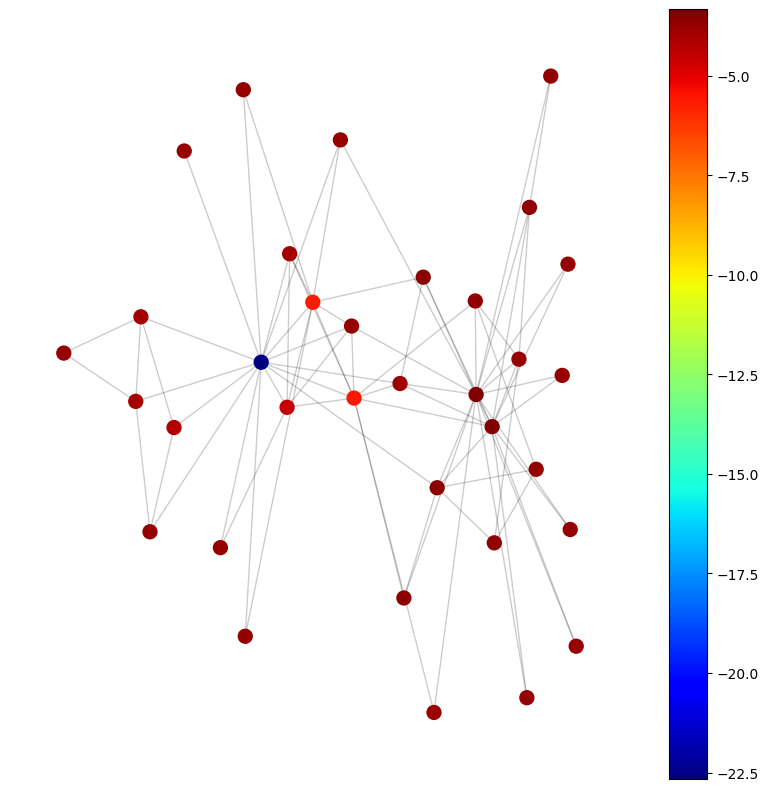

In [ ]:
plotting(G, 'Vulnerability CD', pos)

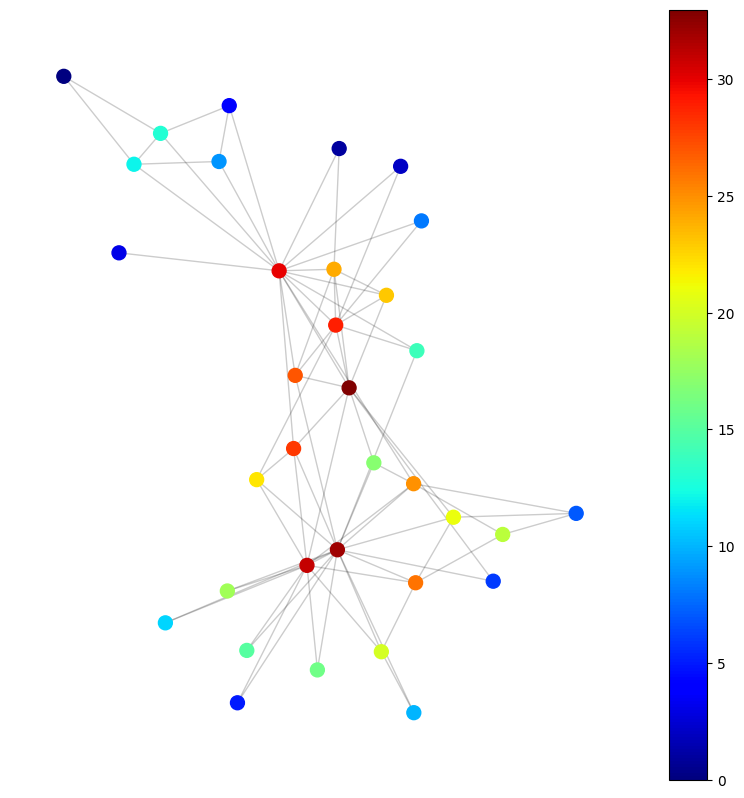

In [ ]:
plotting(G, 'Vulnerability Communicability', pos)

In [ ]:
px.scatter(df, "Vulnerability Communicability", "Vulnerability Comm Ang")